## Visual Data With Bouding Box

Image File: blur_09089.jpg



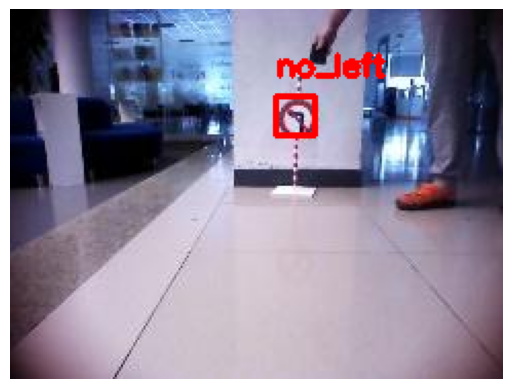

Image File: snow_00599.jpg



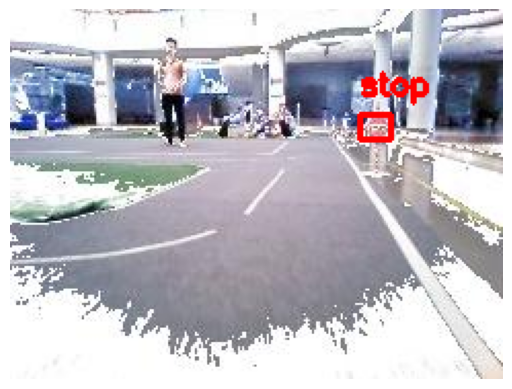

Image File: noise_00156.jpg



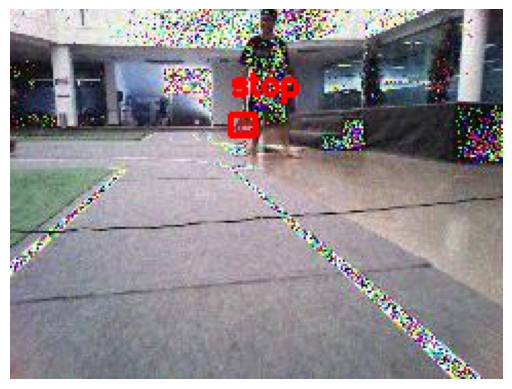

Image File: blur_01157.jpg



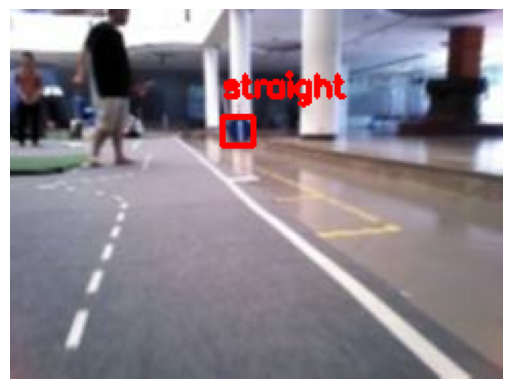

Image File: 08963.jpg



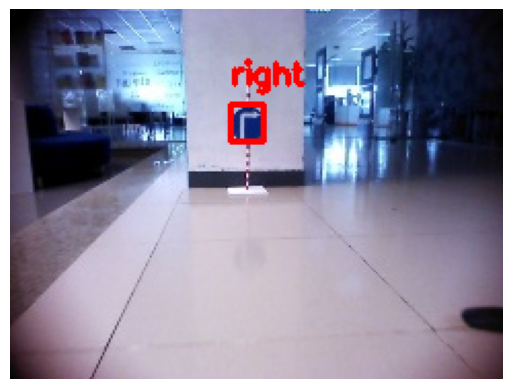

Image File: blur_01149.jpg



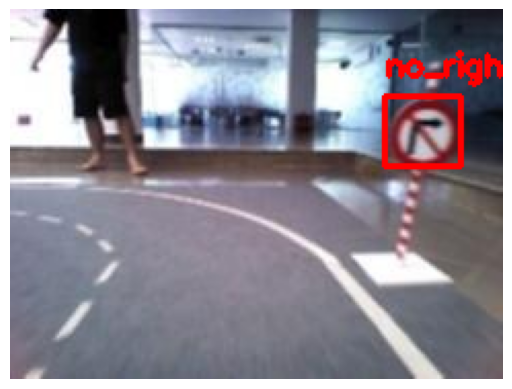

Image File: flare_02701.jpg



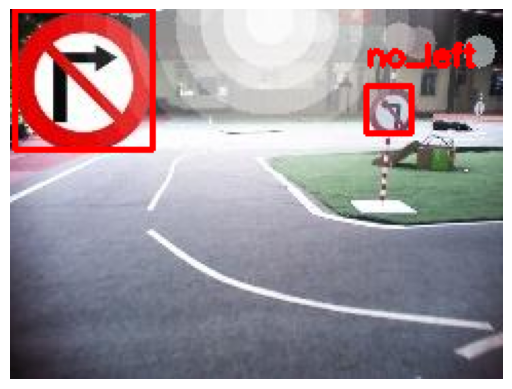

Image File: snow_01960.jpg



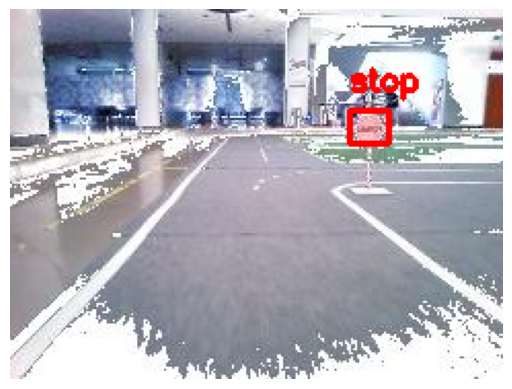

Image File: 05038.jpg



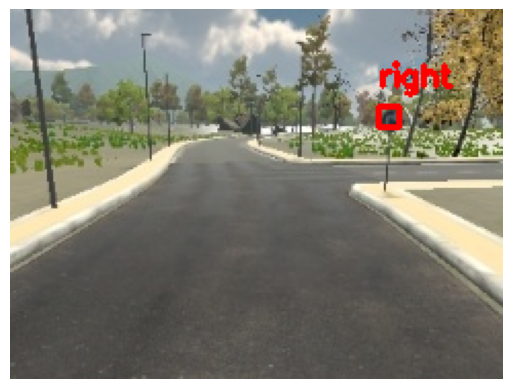

Image File: 09006.jpg



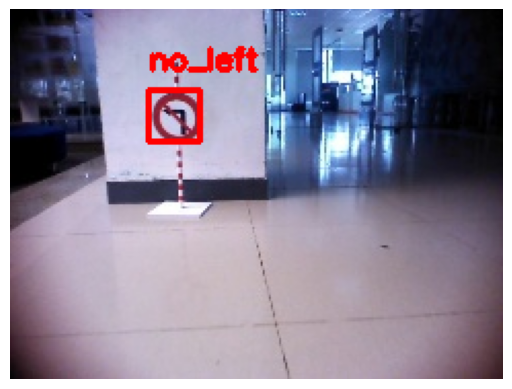

Image File: 00209.jpg



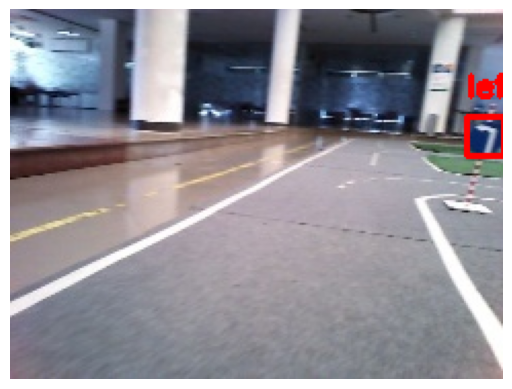

Image File: 07172.jpg



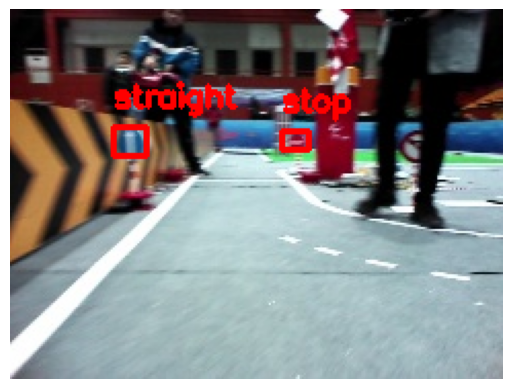

Image File: noise_03779.jpg



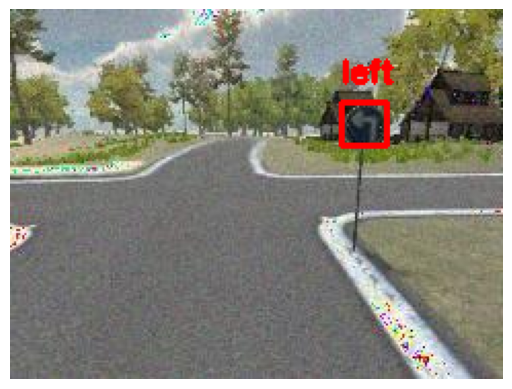

Image File: brightness_05096.jpg



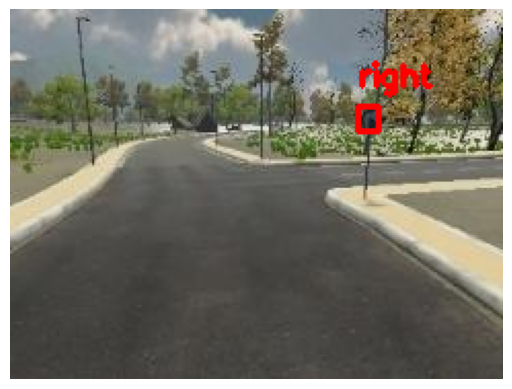

Image File: brightness_05002.jpg



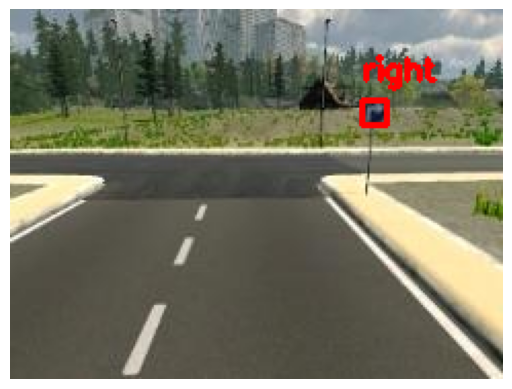

Image File: shadow_03281.jpg



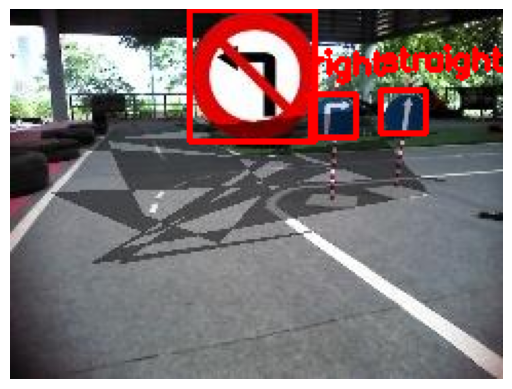

Image File: shadow_01537.jpg



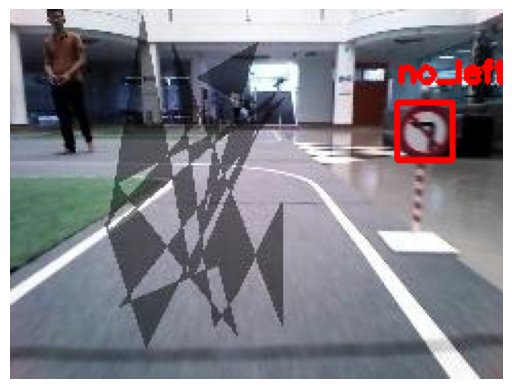

Image File: fog_05411.jpg



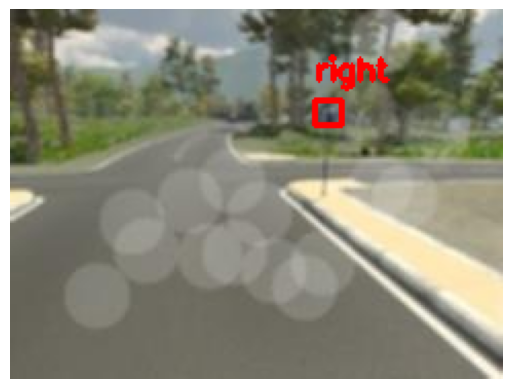

Image File: shadow_05943.jpg



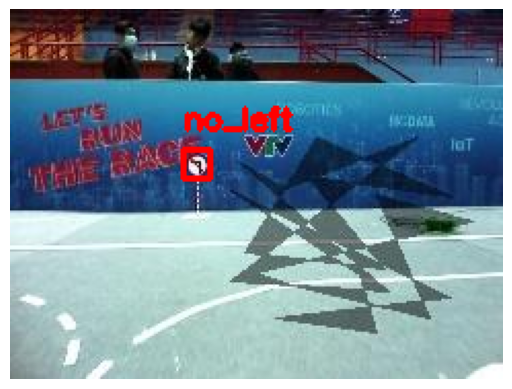

Image File: rain_06586.jpg



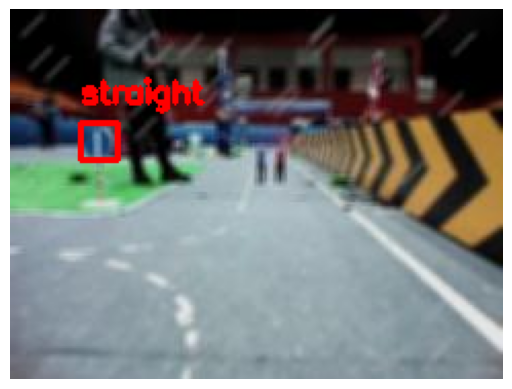

Image File: snow_01923.jpg



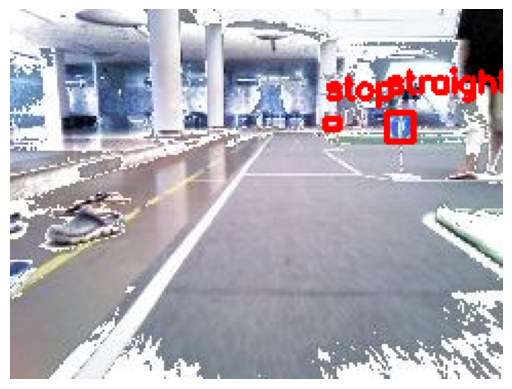

Image File: shadow_00926.jpg



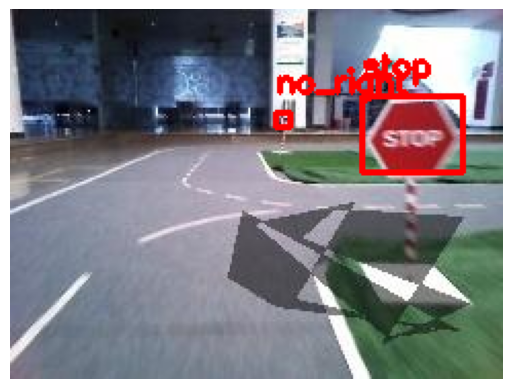

Image File: snow_04002.jpg



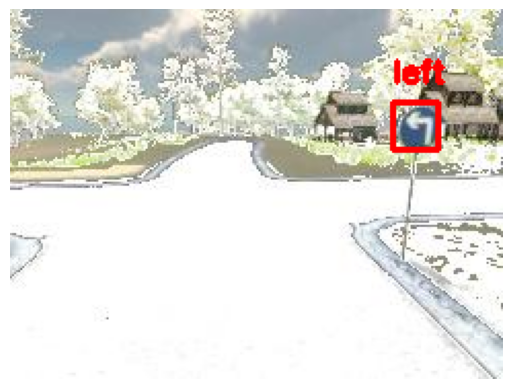

Image File: 08695.jpg



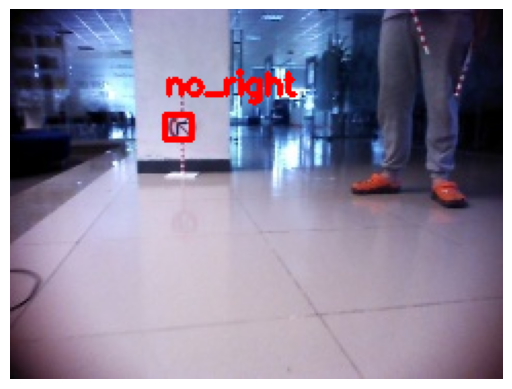

Image File: noise_07456.jpg



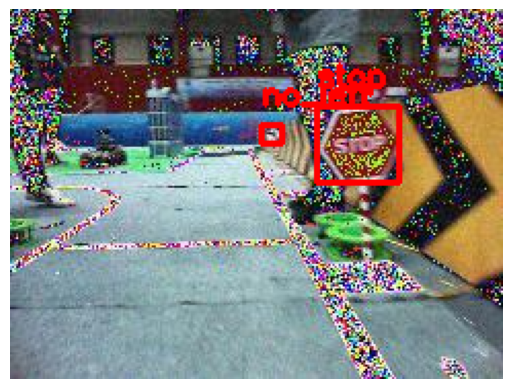

Image File: 00317.jpg



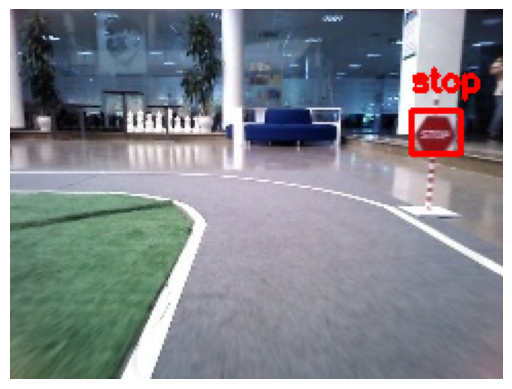

Image File: fog_10240.jpg



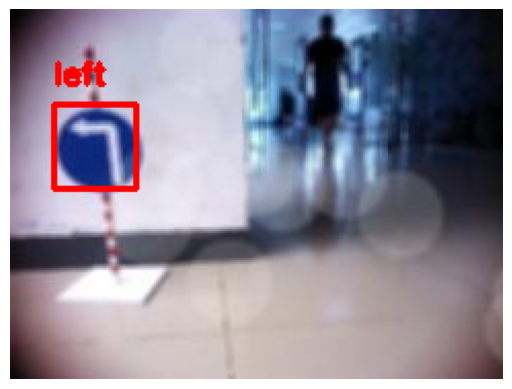

Image File: brightness_00348.jpg



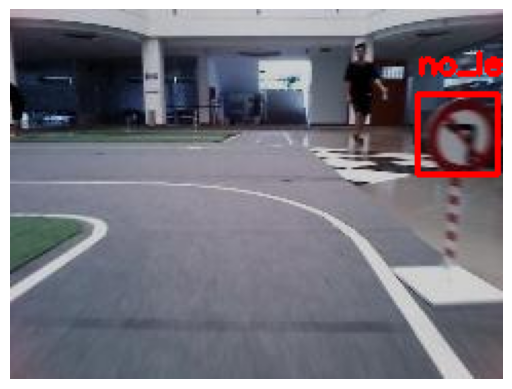

Image File: 09463.jpg



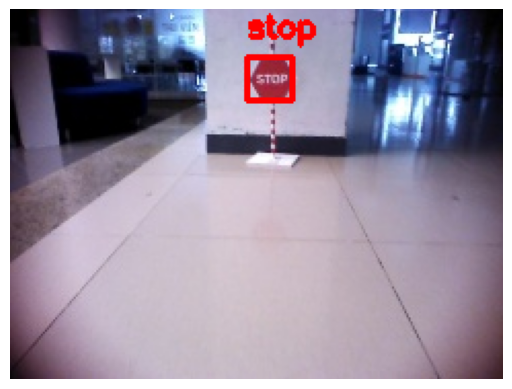

Image File: rain_07917.jpg



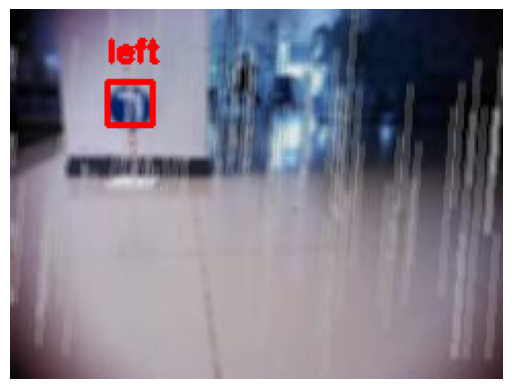

Image File: noise_05928.jpg



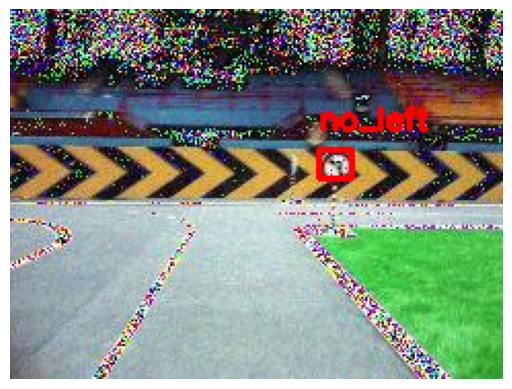

Image File: 04581.jpg



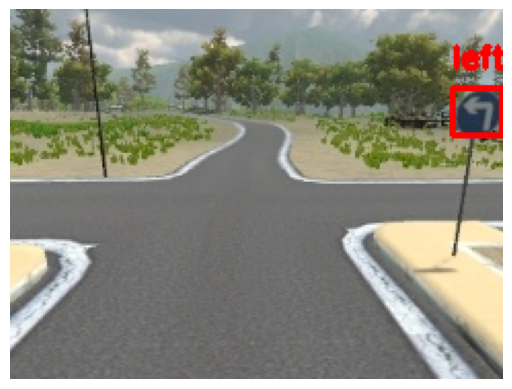

Image File: snow_01001.jpg



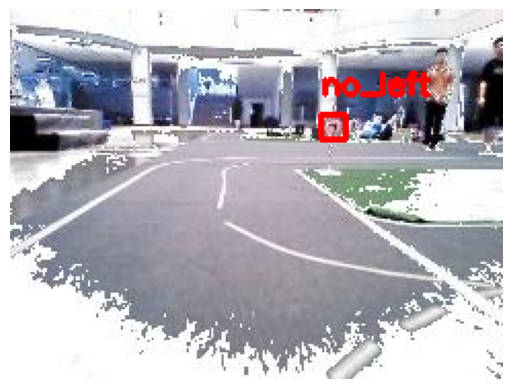

Image File: flare_01853.jpg



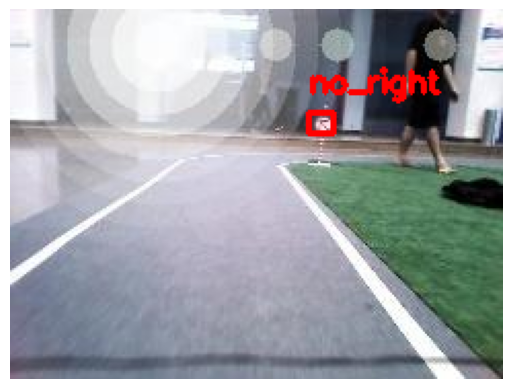

Image File: snow_00032.jpg



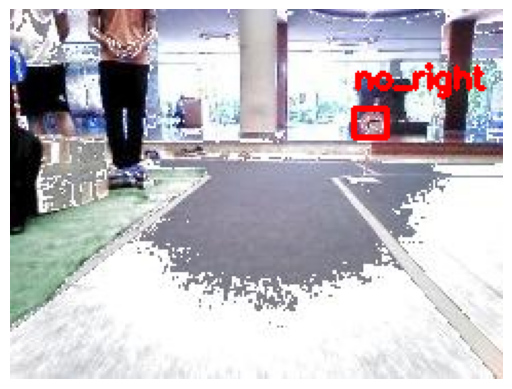

Image File: blur_01960.jpg



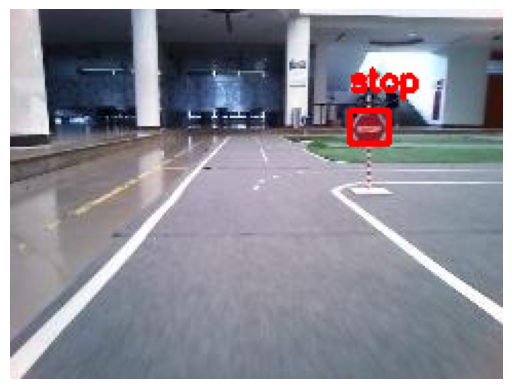

Image File: brightness_01959.jpg



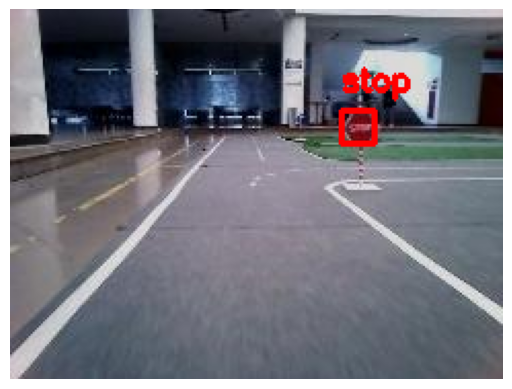

Image File: snow_01434.jpg



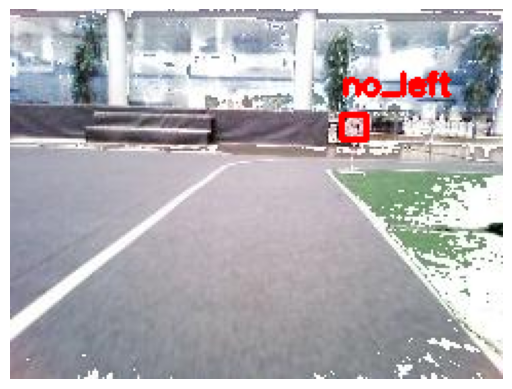

Image File: 04379.jpg



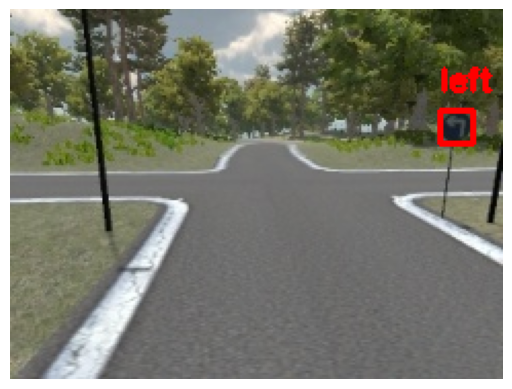

Image File: 07914.jpg



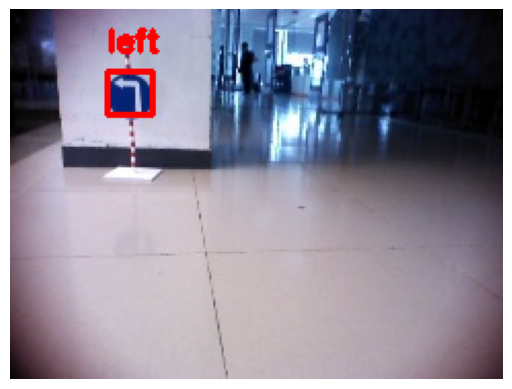

Image File: 01567.jpg



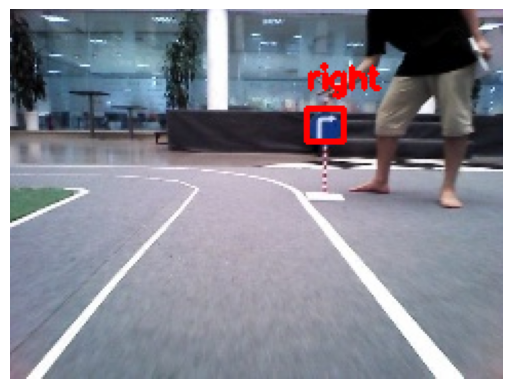

Image File: fog_02076.jpg



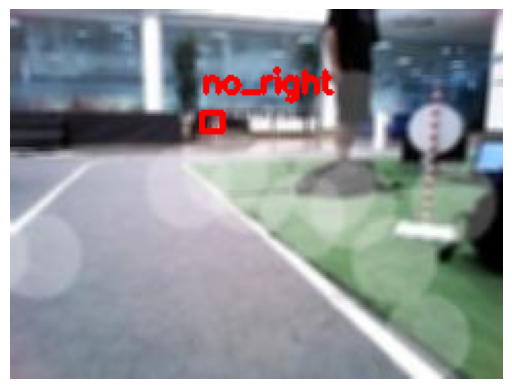

Image File: rain_07126.jpg



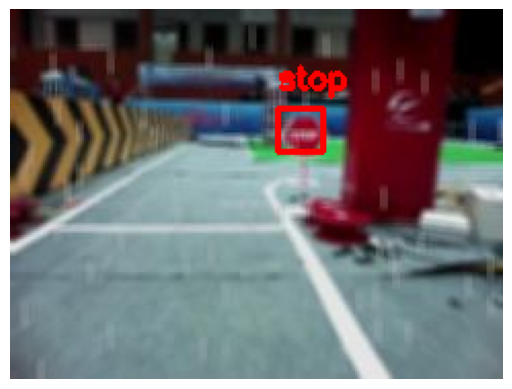

Image File: noise_00898.jpg



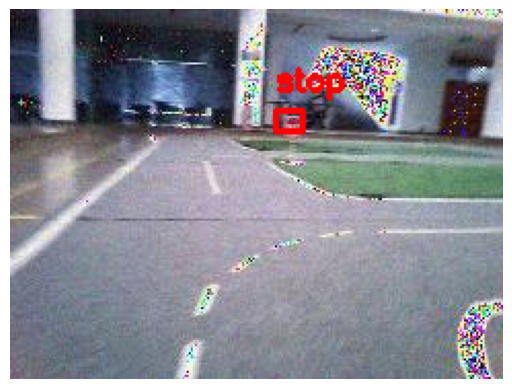

Image File: noise_00644.jpg



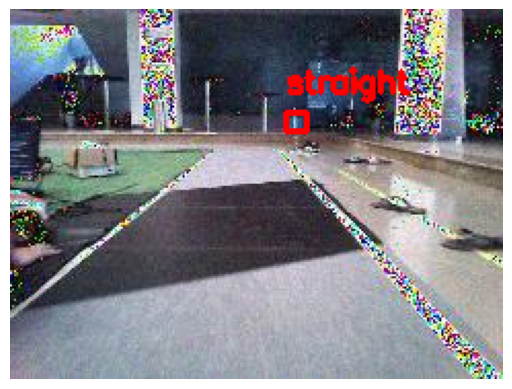

Image File: noise_00148.jpg



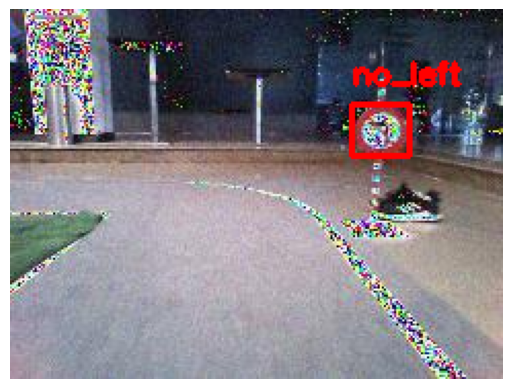

Image File: rain_09801.jpg



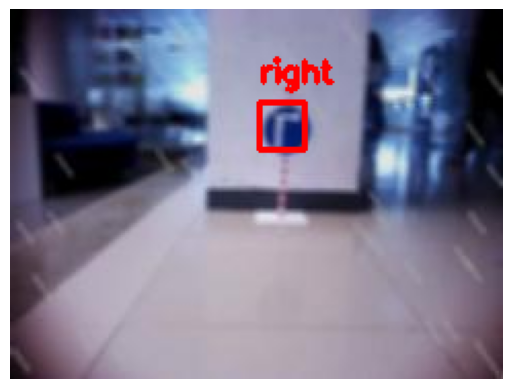

Image File: rain_02402.jpg



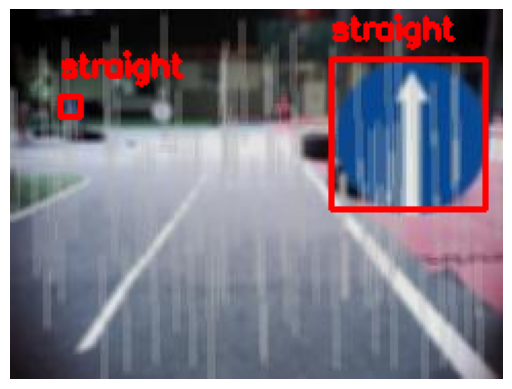

Image File: 06834.jpg



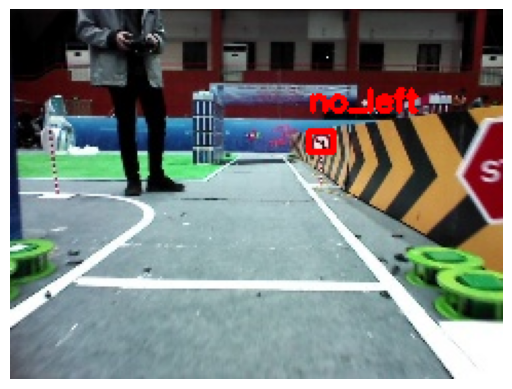

Image File: noise_01915.jpg



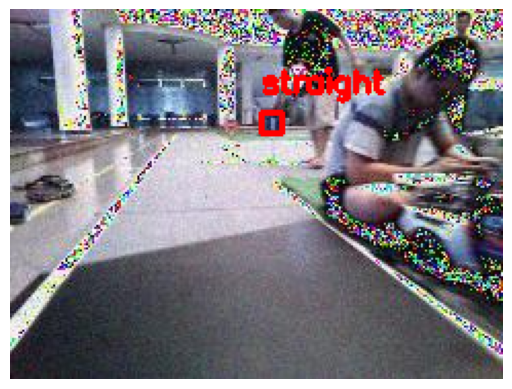

Image File: 06073.jpg



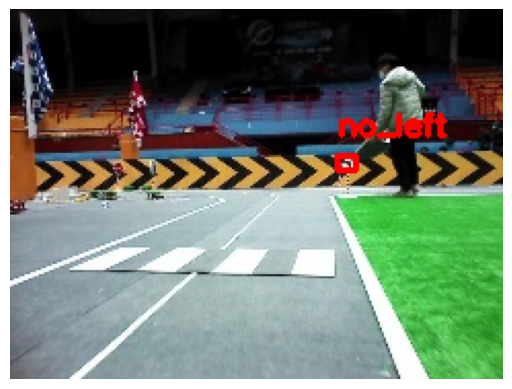

Image File: 02019.jpg



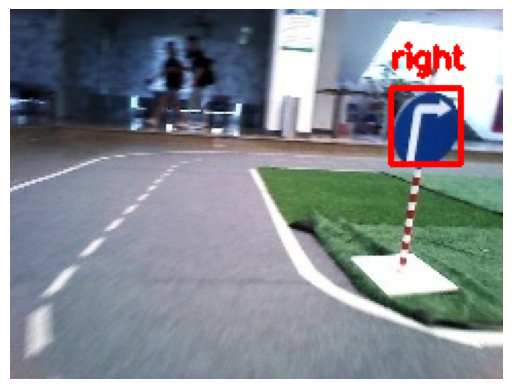

Image File: 01444.jpg



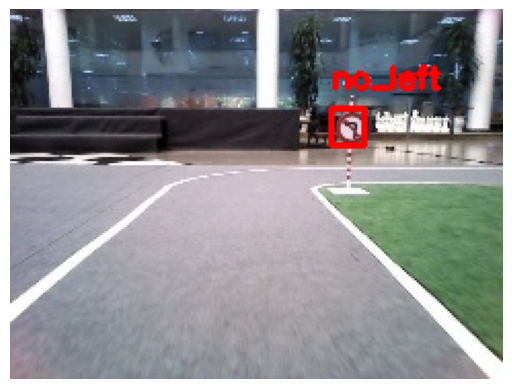

Image File: 00589.jpg



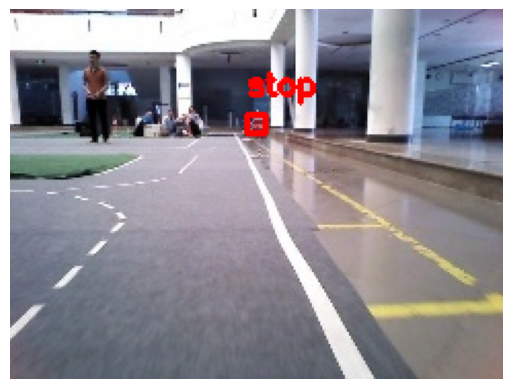

Image File: blur_04345.jpg



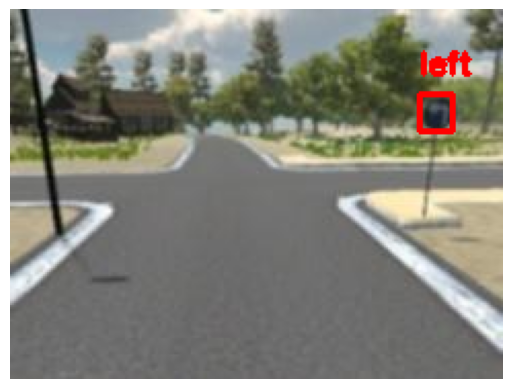

Image File: blur_07710.jpg



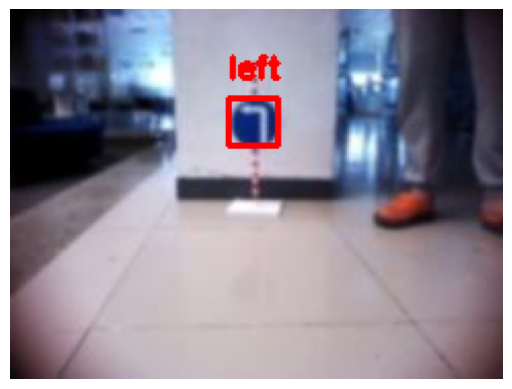

Image File: 02035.jpg



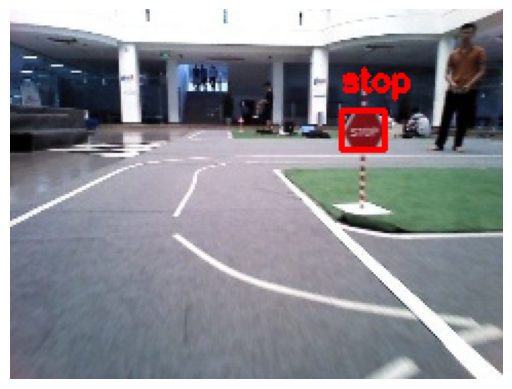

Image File: shadow_08264.jpg



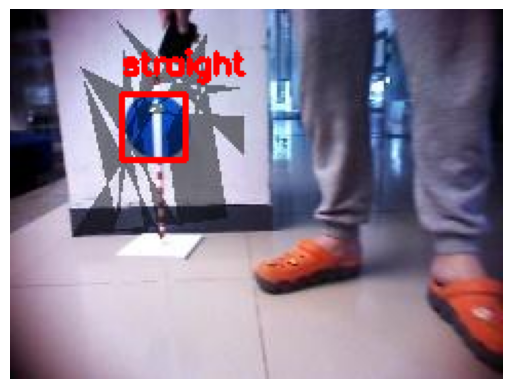

Image File: brightness_00249.jpg



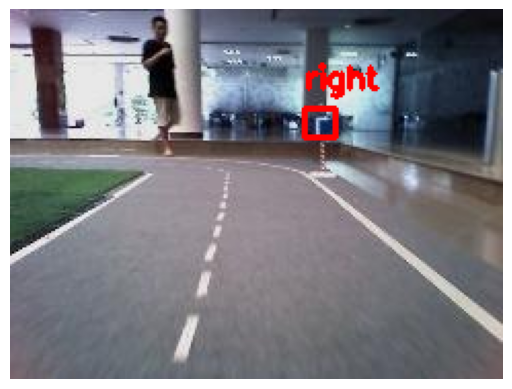

Image File: 00836.jpg



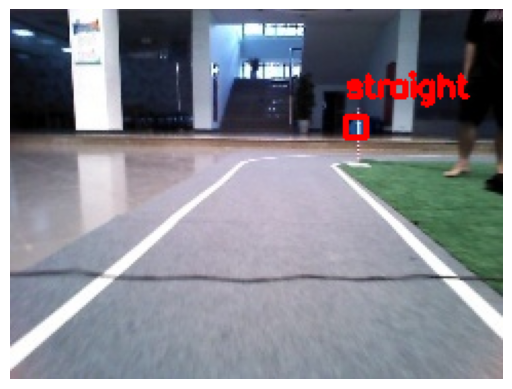

Image File: rain_01853.jpg



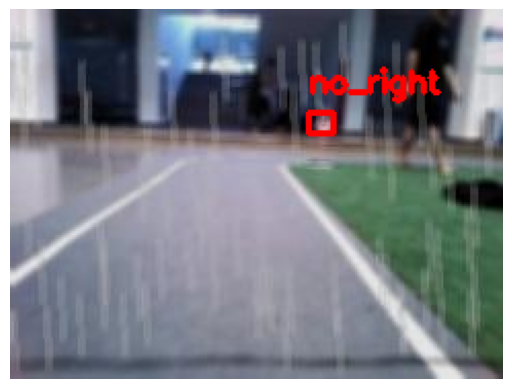

Image File: snow_09997.jpg



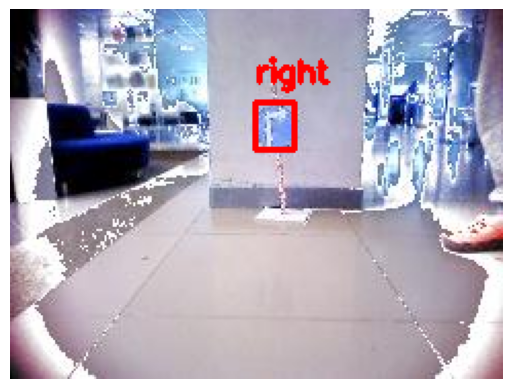

Image File: 00061.jpg



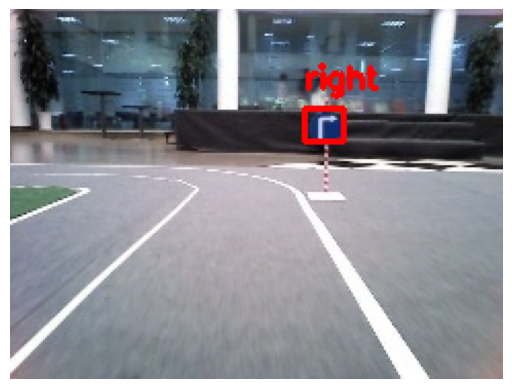

Image File: 07111.jpg



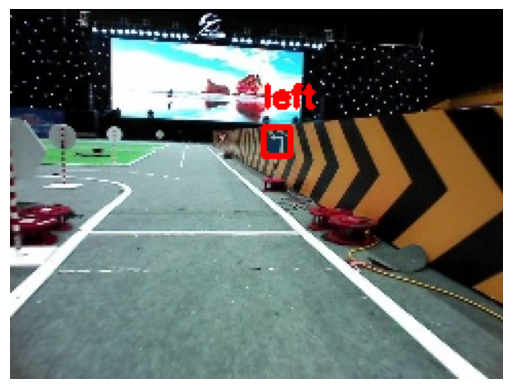

Image File: shadow_09804.jpg



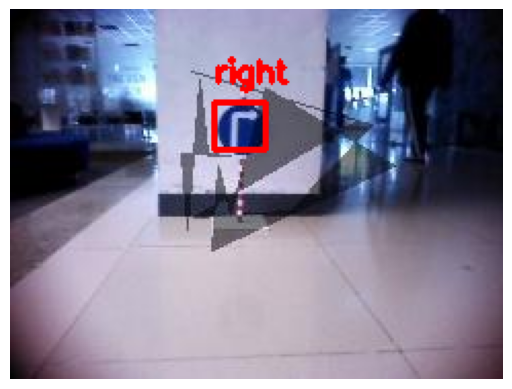

Image File: 00146.jpg



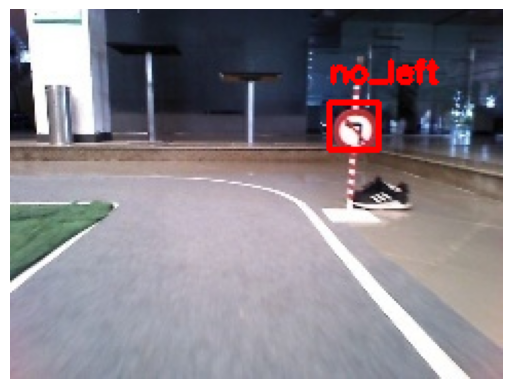

Image File: flare_01439.jpg



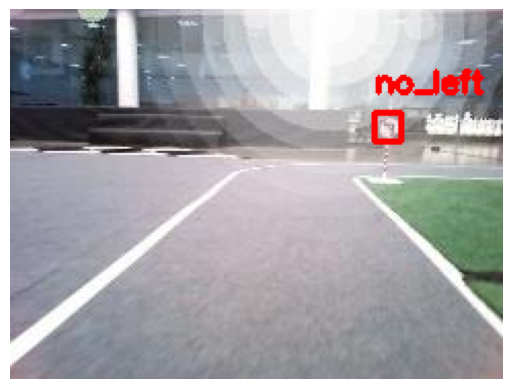

Image File: shadow_07500.jpg



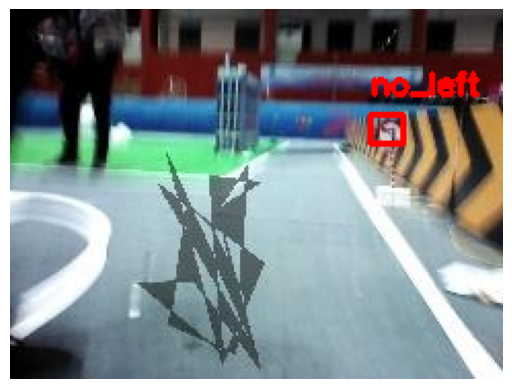

Image File: blur_00044.jpg



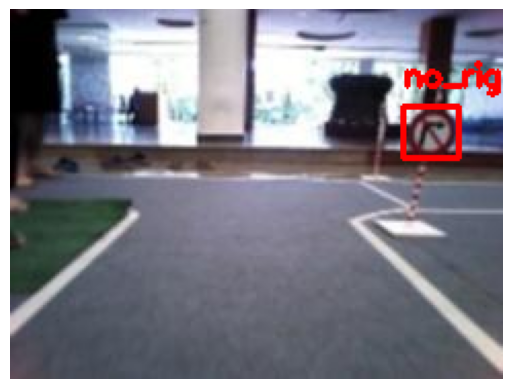

Image File: snow_01940.jpg



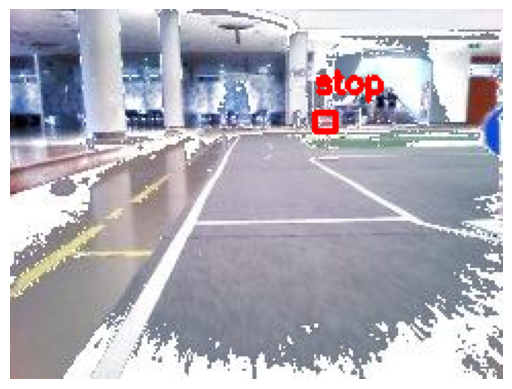

Image File: flare_09806.jpg



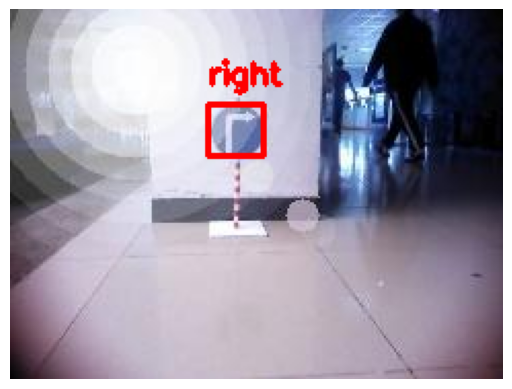

Image File: snow_05386.jpg



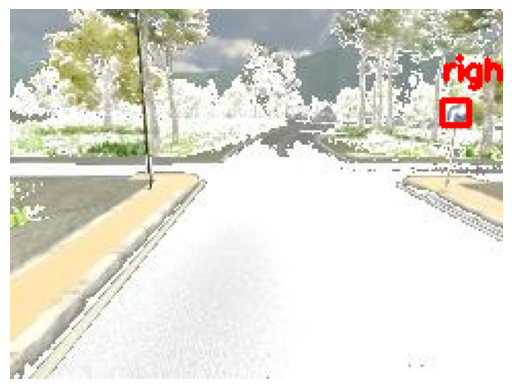

Image File: noise_04042.jpg



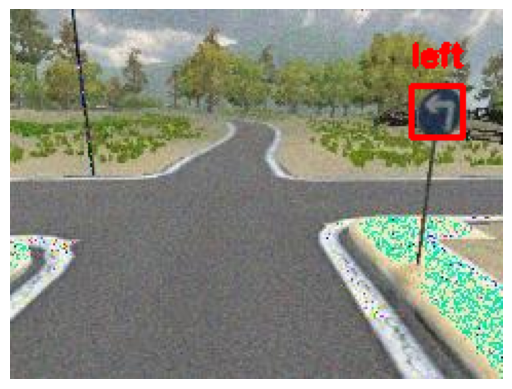

Image File: blur_00129.jpg



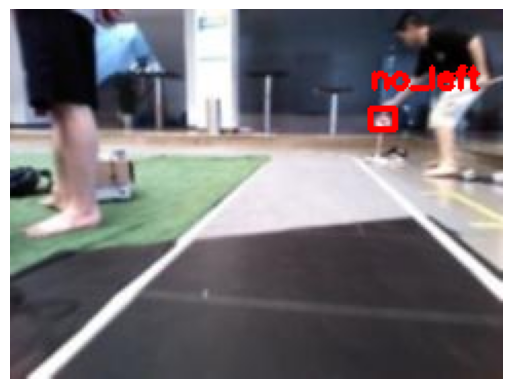

Image File: rain_02256.jpg



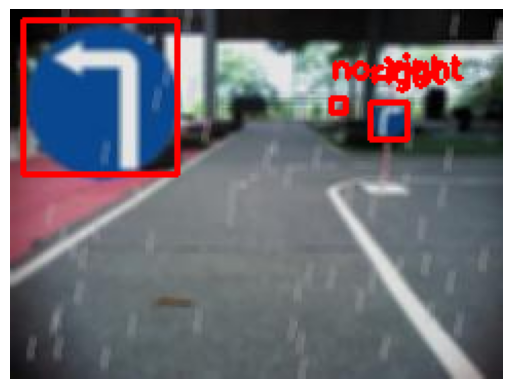

Image File: shadow_04659.jpg



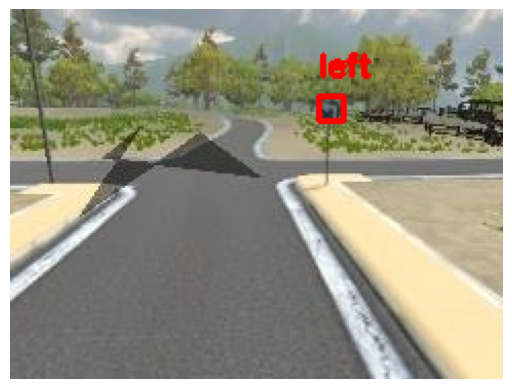

Image File: brightness_01149.jpg



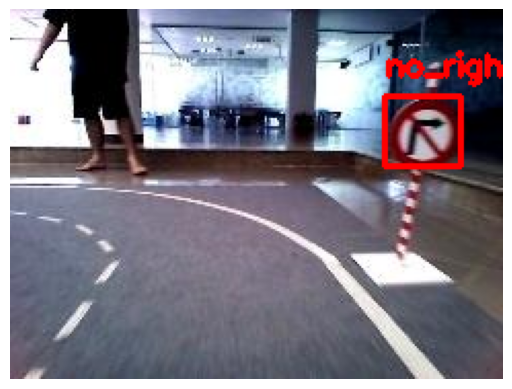

Image File: rain_02268.jpg



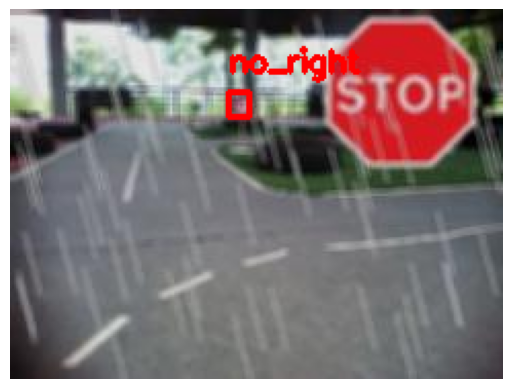

Image File: 00291.jpg



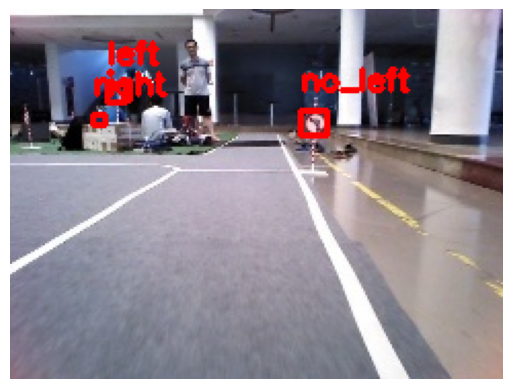

Image File: noise_00281.jpg



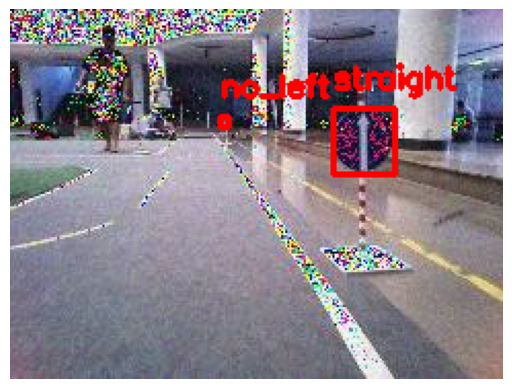

Image File: brightness_09341.jpg



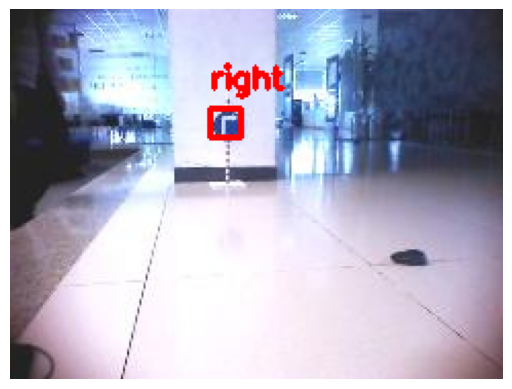

Image File: flare_08851.jpg



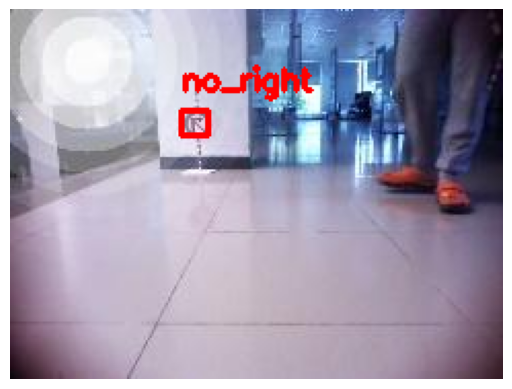

Image File: fog_03907.jpg



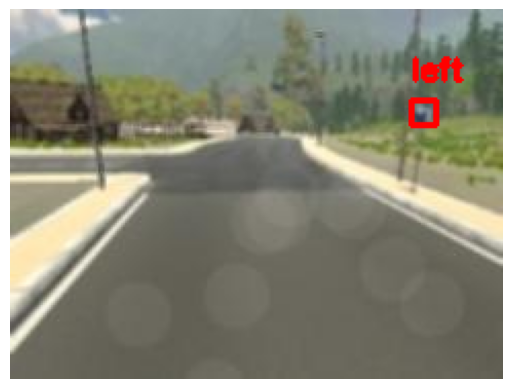

Image File: noise_07938.jpg



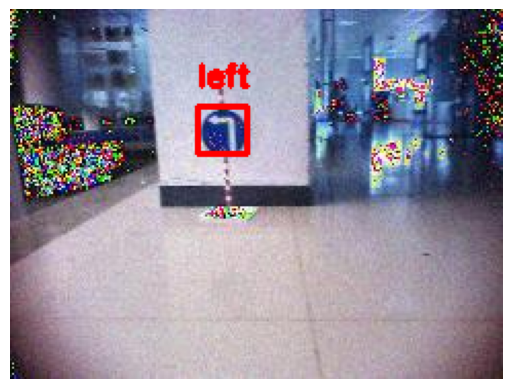

Image File: rain_02428.jpg



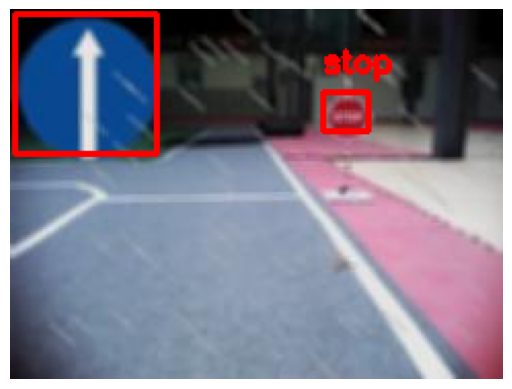

Image File: rain_00544.jpg



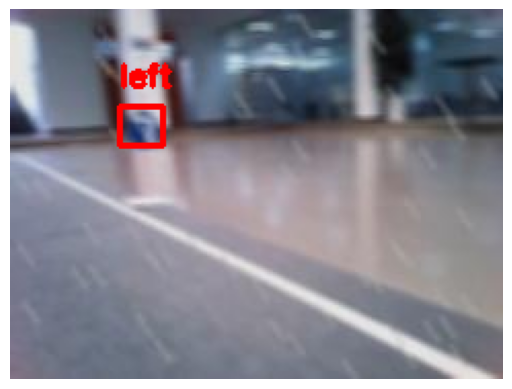

Image File: flare_04609.jpg



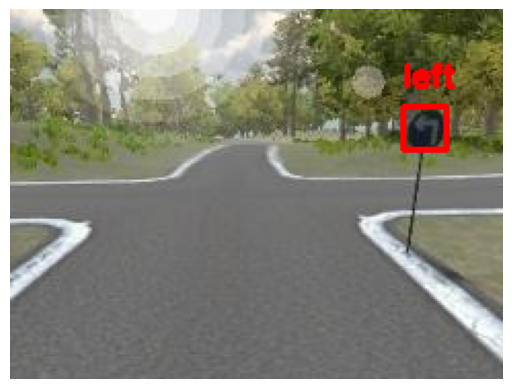

Image File: blur_00196.jpg



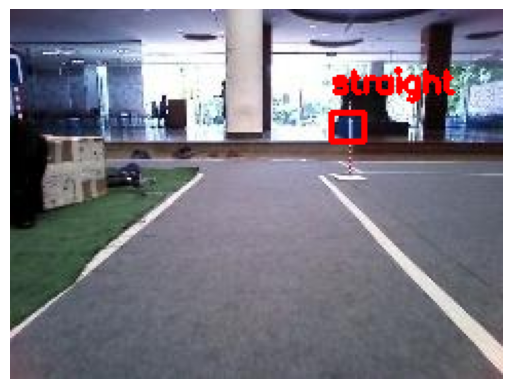

Image File: blur_10183.jpg



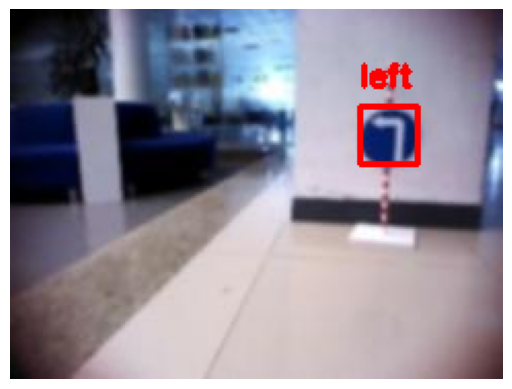

Image File: 02139.jpg



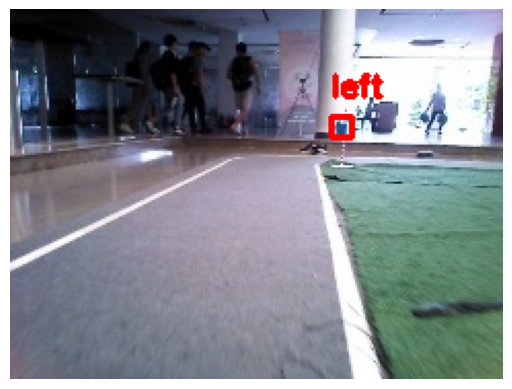

Image File: blur_09716.jpg



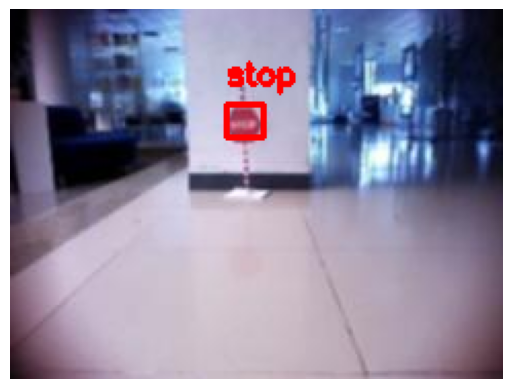

Image File: flare_00602.jpg



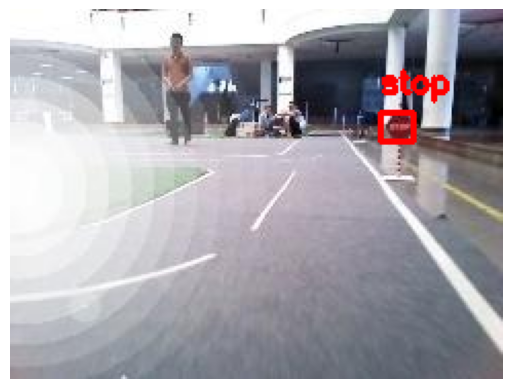

Image File: fog_00161.jpg



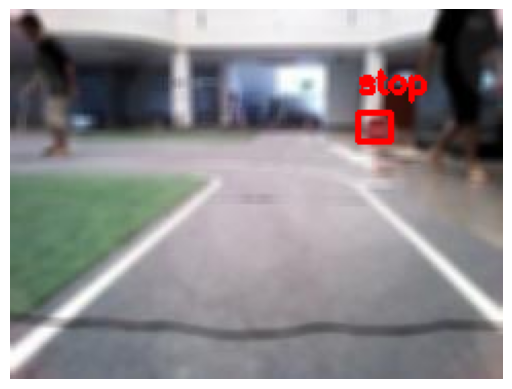

Image File: 07906.jpg



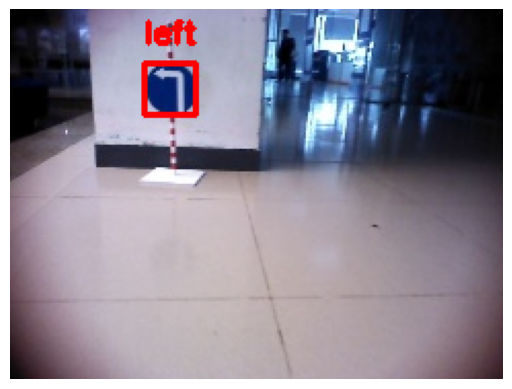

Image File: blur_01708.jpg



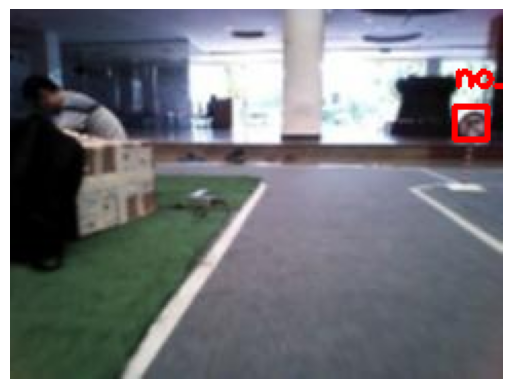

Image File: rain_01622.jpg



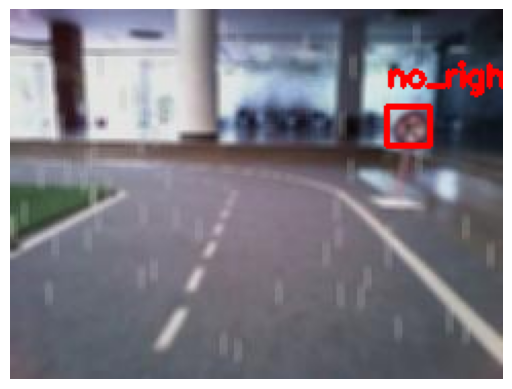

Image File: shadow_02459.jpg



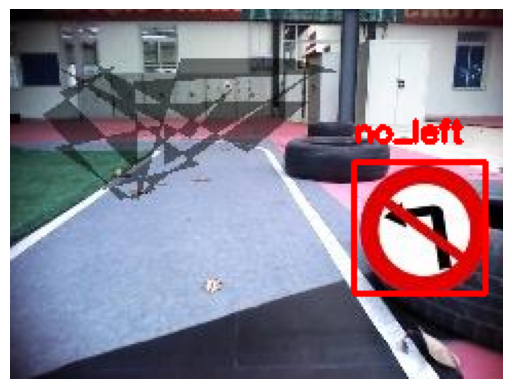

Image File: 08916.jpg



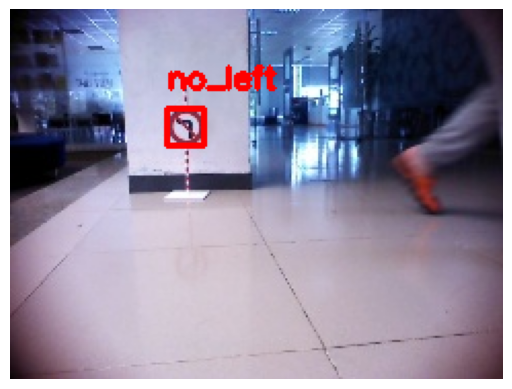

Image File: snow_00519.jpg



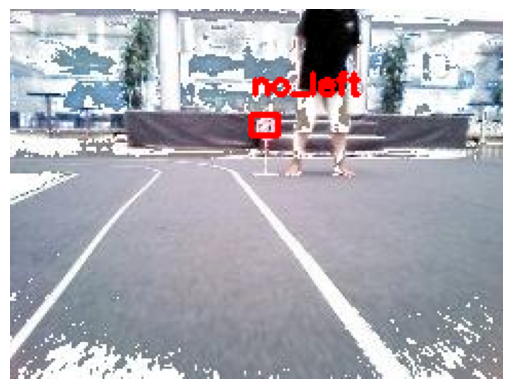

Image File: 08342.jpg



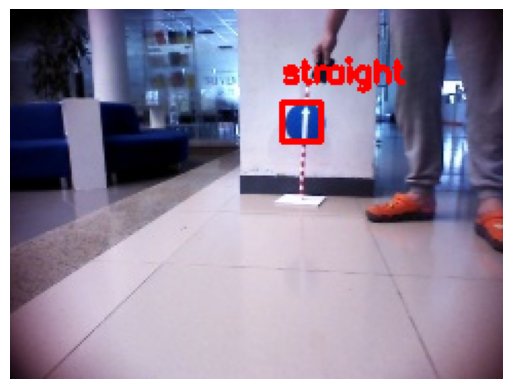

All images processed.


In [1]:
import os
import cv2
import random
import matplotlib.pyplot as plt

images_folder = r"C:\Users\LAPTOP\Desktop\Traffic Sign Detection With Yolo\Result data\train\images"
labels_folder = r"C:\Users\LAPTOP\Desktop\Traffic Sign Detection With Yolo\Result data\train\labels"

category_names = {
    0: "stop",
    1: "left",
    2: "right",
    3: "straight",
    4: "no_left",
    5: "no_right"
}

label_files = [f for f in os.listdir(labels_folder) if f.endswith('.txt')]

random_label_files = random.sample(label_files, 100)

for label_file in random_label_files:
    image_filename = f"{os.path.splitext(label_file)[0]}.jpg"
    image_path = os.path.join(images_folder, image_filename)

    image = cv2.imread(image_path)
    if image is None:
        print(f"Could not read image {image_filename}. Skipping...")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    print(f"Image File: {image_filename}\n")

    label_file_path = os.path.join(labels_folder, label_file)
    with open(label_file_path, 'r') as f:
        lines = f.readlines()
        for line in lines:
            label_parts = line.strip().split()
            category_id = int(label_parts[0])
            x_center, y_center, w, h = map(float, label_parts[1:])

            image_height, image_width, _ = image.shape
            x = int((x_center - w / 2) * image_width)
            y = int((y_center - h / 2) * image_height)
            w = int(w * image_width)
            h = int(h * image_height)

            category_name = category_names.get(category_id, 'Unknown')
            cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)
            cv2.putText(image, f"{category_name}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
    
    plt.imshow(image)
    plt.axis('off')  
    plt.show()

print("All images processed.")


In [ ]:
# import os
# import random
# from PIL import Image
# import shutil
# import albumentations as A
# from crop import RandomCrop  # Import the RandomCrop class from crop.py
# from weather import RandomRain  # Import the RandomRain class from weather.py

# def augment_images(image_dir, label_dir, output_image_dir, output_label_dir, num_images=500):
#     random.seed(42)  # Set a seed for reproducibility

#     # Create an instance of RandomCrop
#     random_crop = RandomCrop()
#     random_rain = RandomRain()

#     # List all image files in the directory
#     image_files = os.listdir(image_dir)
#     random.shuffle(image_files)  # Shuffle the list of images

#     # Iterate over the first num_images files (or all if less than num_images)
#     for i, image_file in enumerate(image_files[:num_images]):
#         image_path = os.path.join(image_dir, image_file)
#         label_path = os.path.join(label_dir, image_file.replace('.jpg', '.txt'))

#         # Open image using PIL
#         with Image.open(image_path) as img:
#             # Perform augmentation (random crop in this example)
#             img = random_crop(img)

#             # Save augmented image to output image directory
#             augmented_image_path = os.path.join(output_image_dir, f"augmented_{i}.jpg")
#             img.save(augmented_image_path)

#             # Rename label file to match the augmented image name
#             augmented_label_path = os.path.join(output_label_dir, f"augmented_{i}.txt")
#             shutil.copy(label_path, augmented_label_path)

#         print(f"Augmented image {i + 1}/{num_images}")

#     print("Augmentation complete.")

# # Example usage
# if __name__ == "__main__":
#     image_dir = r"C:\Users\LAPTOP\Desktop\Traffic Sign Detection With Yolo\Data Converted(-80%)\train\images"
#     label_dir = r"C:\Users\LAPTOP\Desktop\Traffic Sign Detection With Yolo\Data Converted(-80%)\train\labels"
#     output_image_dir = r"C:\Users\LAPTOP\Desktop\Traffic Sign Detection With Yolo\Result data\train\images"
#     output_label_dir = r"C:\Users\LAPTOP\Desktop\Traffic Sign Detection With Yolo\Result data\train\labels"
    
#     augment_images(image_dir, label_dir, output_image_dir, output_label_dir)